# Time Series Multi-Step Forecasting Comparison

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Models-Evaluation-Methodology" data-toc-modified-id="Models-Evaluation-Methodology-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Models Evaluation Methodology</a></span></li><li><span><a href="#EEG:-Fp1-(Left-Frontopolar-Cloth-Surface-Electrode-on-the-Forehead)" data-toc-modified-id="EEG:-Fp1-(Left-Frontopolar-Cloth-Surface-Electrode-on-the-Forehead)-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>EEG: Fp1 (Left Frontopolar Cloth Surface Electrode on the Forehead)</a></span><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#SARIMA-for-EEG:-Fp1" data-toc-modified-id="SARIMA-for-EEG:-Fp1-2.0.1"><span class="toc-item-num">2.0.1&nbsp;&nbsp;</span>SARIMA for EEG: Fp1</a></span></li></ul></li></ul></li><li><span><a href="#Website-Visits:-Page-Loads" data-toc-modified-id="Website-Visits:-Page-Loads-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Website Visits: Page Loads</a></span><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#SARIMA-for-Page-Loads" data-toc-modified-id="SARIMA-for-Page-Loads-3.0.1"><span class="toc-item-num">3.0.1&nbsp;&nbsp;</span>SARIMA for Page Loads</a></span></li></ul></li></ul></li><li><span><a href="#Weather" data-toc-modified-id="Weather-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Weather</a></span><ul class="toc-item"><li><span><a href="#Wind-Speed" data-toc-modified-id="Wind-Speed-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>Wind Speed</a></span></li></ul></li><li><span><a href="#Covid-19:-Daily-New-Cases-in-Argentina" data-toc-modified-id="Covid-19:-Daily-New-Cases-in-Argentina-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Covid-19: Daily New Cases in Argentina</a></span><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#SARIMA-for-Covid-19-in-Argentina" data-toc-modified-id="SARIMA-for-Covid-19-in-Argentina-5.0.1"><span class="toc-item-num">5.0.1&nbsp;&nbsp;</span>SARIMA for Covid-19 in Argentina</a></span></li></ul></li></ul></li><li><span><a href="#Forex-Currencies-Rates:-GBP/USD" data-toc-modified-id="Forex-Currencies-Rates:-GBP/USD-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Forex Currencies Rates: GBP/USD</a></span></li></ul></div>

In [2]:
# !pip install --use-feature=in-tree-build psutil requests pmdarima nb_black

In [3]:
# !pip install --use-feature=in-tree-build ../pytorch-fit/
# !pip install --use-feature=in-tree-build git+https://github.com/krzpiesiewicz/pytorch-fit

In [4]:
# !pip install --use-feature=in-tree-build ../timeseries/
# !pip install --use-feature=in-tree-build git+https://github.com/krzpiesiewicz/timeseries

In [5]:
%load_ext nb_black
%load_ext autoreload
%autoreload 2
# %aimport pytorch_fit
%aimport timeseries

# unnecessary:
# %aimport results
# %aimport average_scoring
# %aimport hyper_params
# %aimport median_of_medians
# %aimport sarima
# %aimport plotting

from utils.notebook_init import notebook_init

notebook_init()

<IPython.core.display.Javascript object>

In [7]:
import os
import nb_black
import IPython.display
from pprint import pprint
from datetime import datetime, timedelta
import numpy as np
import pandas as pd
import sklearn
import sklearn.metrics
import pmdarima as pm

# import torch
# from torch import nn
# from torch.nn import functional as F
# from torch import optim
# from torch.utils.data import Dataset, DataLoader
# import pytorch_fit
# from pytorch_fit import fit, train_epoch, evaluate
import timeseries as tss
from timeseries.plotting import plot_ts, plot_hist
from timeseries.transform import IHSTransformer, get_smoothed

from utils.timeseries_data import ForexGBPUSDData, EEGData
from utils.results import Results
from average_scoring import average_scores
from hyper_params import make_grid, grid_search_hyper_params
from models.median_of_medians import MedianOfMediansModel
from models.sarima import SarimaModel
from utils.plotting import (
    plot_model_test_prediction,
    plot_ground_truth,
    plot_hist_model_scores,
)

<IPython.core.display.Javascript object>

In [ ]:
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Models Evaluation Methodology

scorings: RMSE, MAE, MASE, sMAPE

In [8]:
scorings = ["RMSE", "MAE", "MASE", "sMAPE"]

gbpusd_data = ForexGBPUSDData()
gpdusd_results = Results(gbpusd_data.data_type, gbpusd_data.data_name, "test")

<IPython.core.display.Javascript object>

In [9]:
def sarima_grid_search(scores=None):
    return grid_search_hyper_params(
        SarimaModel,
        grid,
        trans_ts,
        hyper_search_train_intv,
        hyper_search_val_intv,
        model_params=model_params,
        score_params=score_params,
        fit_params=fit_params,
        best=10,
        scores=scores,
    )


def median_of_medians_grid_search(scores=None):
    return grid_search_hyper_params(
        MedianOfMediansModel,
        grid,
        ts,
        hyper_search_train_intv,
        hyper_search_val_intv,
        best=10,
        score_params=score_params,
        scores=scores,
    )

<IPython.core.display.Javascript object>

In [10]:
# print(f"{model_name} – {data_type}: {data_name}")
# preds = load_preds(data_type, data_name, model_name, mode)
# all_scores = get_all_scores(ts, test_preds, scorings)
# mean_scores = get_mean_scores(test_all_scores)

# save_model_scores_and_preds(data_type, data_name, model_name, mode, mean_scores)
# scores_table()

<IPython.core.display.Javascript object>

## EEG: Fp1 (Left Frontopolar Cloth Surface Electrode on the Forehead)

In [15]:
eeg_data = pd.read_csv("data/eeg_features_raw.csv")
eeg_data

,Fp1,AF3,F3,F7,FC5,FC1,C3,T7,CP5,CP1,...,Cz,C4,T8,CP6,CP2,P4,P8,PO4,O2,Unnamed: 32
0,0.057813,-1.335266,4.640480,0.219573,7.473817,2.314842,1.918097,-9.257533,9.089943,-7.104519,...,-2.241480,1.415335,2.406646,12.864059,4.021099,-2.828598,-2.588735,2.637905,-5.226618,NaN
1,1.367408,10.259654,3.345409,7.897852,-2.446051,-1.655035,-6.301423,-7.290317,-3.546453,-5.705187,...,-2.568397,-5.651418,-0.096730,-4.930759,-1.722504,-6.111309,0.094893,-3.521353,1.887093,NaN
2,-1.783132,4.133553,-0.951680,-1.624803,-1.827309,-2.280364,-2.279225,9.151344,-0.239575,-0.057604,...,-2.132823,-0.521117,8.605298,-4.499946,-3.232839,-4.249645,-3.687167,-7.383004,-4.489537,NaN
3,-3.690217,-0.814000,2.295469,0.901445,8.323679,1.127906,6.356886,11.642082,9.354154,-1.662478,...,-0.506117,-1.154866,-3.940251,7.390881,2.129897,-0.794675,-1.959021,2.774530,-6.323060,NaN
4,2.137114,6.420466,6.122230,10.015321,3.106394,3.183129,3.658535,4.571793,4.917712,-2.325940,...,1.813907,-6.444635,-27.680880,0.641364,1.996658,-0.445779,2.614021,6.161845,3.308816,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8059,2.371097,6.525279,-1.470521,-2.535683,-8.222570,-2.062185,-5.890198,11.508550,-14.298769,9.859735,...,0.407407,-0.032451,12.929205,-27.406610,-14.864499,-6.631102,7.509646,-25.823920,-3.558200,NaN
8060,5.408372,7.813431,-5.203169,-13.254773,-18.839062,-1.866768,-8.164257,17.100103,-23.600410,27.898805,...,3.976006,6.957139,11.972493,-52.080426,-29.577173,-11.663913,5.416705,-57.219852,-11.860173,NaN
8061,-1.308237,1.166170,-3.158261,-9.249685,-7.438499,0.591557,-1.791961,16.107009,-9.831608,17.049193,...,3.080318,3.275846,-22.535264,-26.538050,-15.409645,-4.558339,4.718691,-28.783795,-3.566724,NaN
8062,-2.095682,4.284166,-6.136204,-4.000436,-11.495979,-2.753036,-7.090403,5.933243,-13.990339,11.807037,...,0.583702,-1.521174,-12.615231,-26.169920,-16.098081,-6.099934,7.850973,-28.039497,-3.643652,NaN


<IPython.core.display.Javascript object>

In [26]:
print(f"0: {trans_ts.skew()}, 1: {trans_ts1.skew()}")

0: -0.2636032018862265, 1: -0.2636032018862265


<IPython.core.display.Javascript object>

In [29]:
float(32)

32.0

<IPython.core.display.Javascript object>

Order of differencing: 0
Order of differencing: 0
MLE of IHS lambda: 0.13906250000000003


0: 0.8237426399255581, 1: 0.8237426399255581


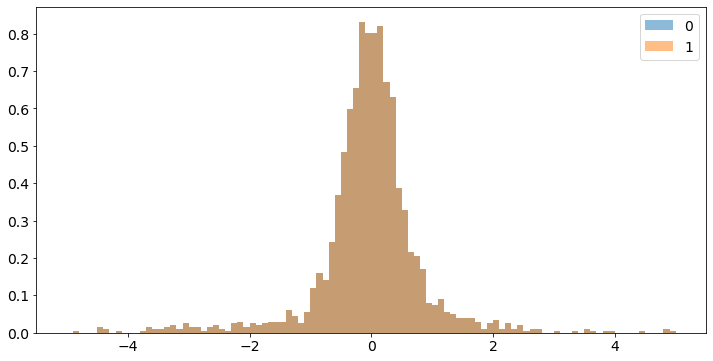

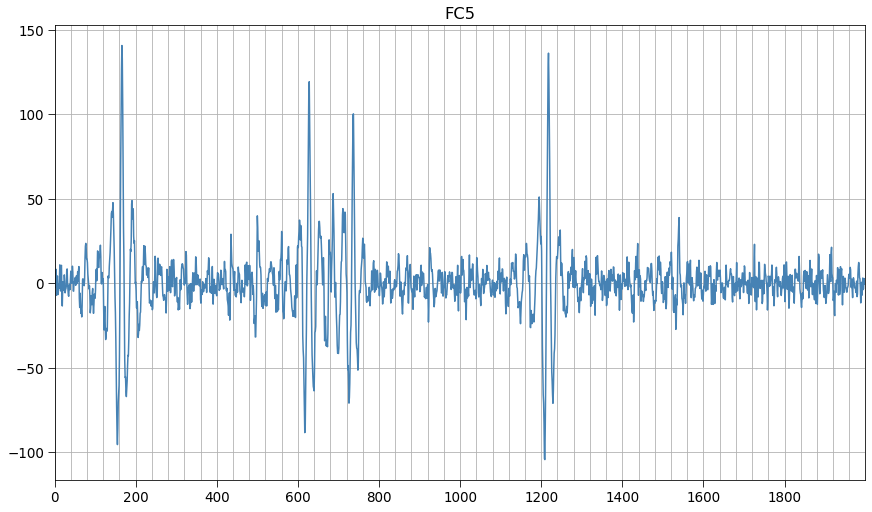

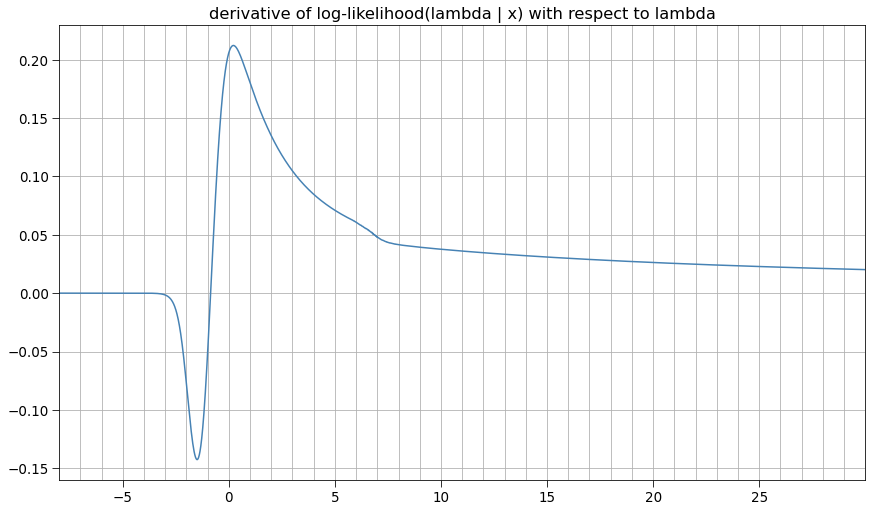

<IPython.core.display.Javascript object>

In [28]:
signal = "FC5"
ts = eeg_data[signal][:500]
trans = IHSTransformer(ts, verbose=True, lmb=None,)
trans_ts = trans.transform(ts)
trans1 = IHSTransformer(ts, verbose=True, save_loglikelihood_deriv=True)
trans_ts1 = trans1.transform(ts)
print(f"0: {trans_ts.skew()}, 1: {trans_ts1.skew()}")
fig = plot_hist(trans_ts, bins=100, range=(-5, 5), density=True, name="0")
plot_hist(trans_ts1, bins=100, range=(-5, 5), density=True, name="1", fig=fig)
display(fig)
display(plot_ts(ts))
plot_ts(trans1.loglikelihood_deriv)



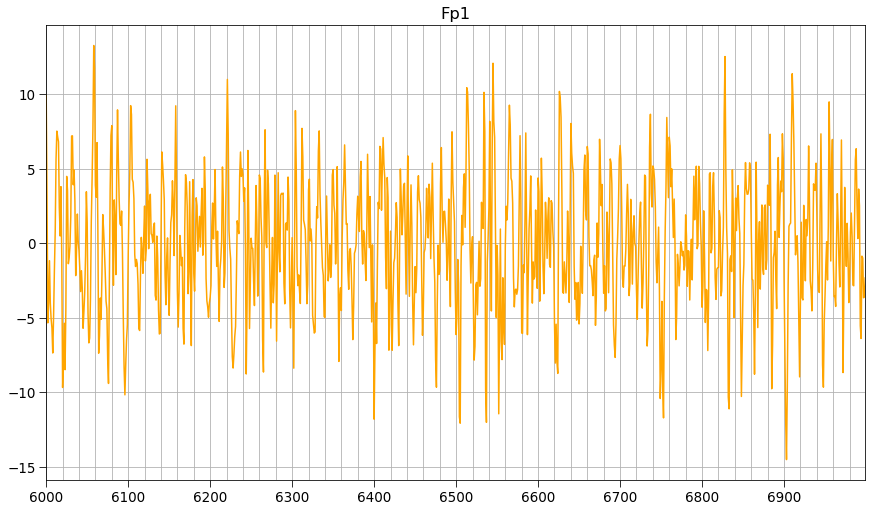

<IPython.core.display.Javascript object>

In [15]:
display(plot_ts(val_intv.view(), color="orange"))

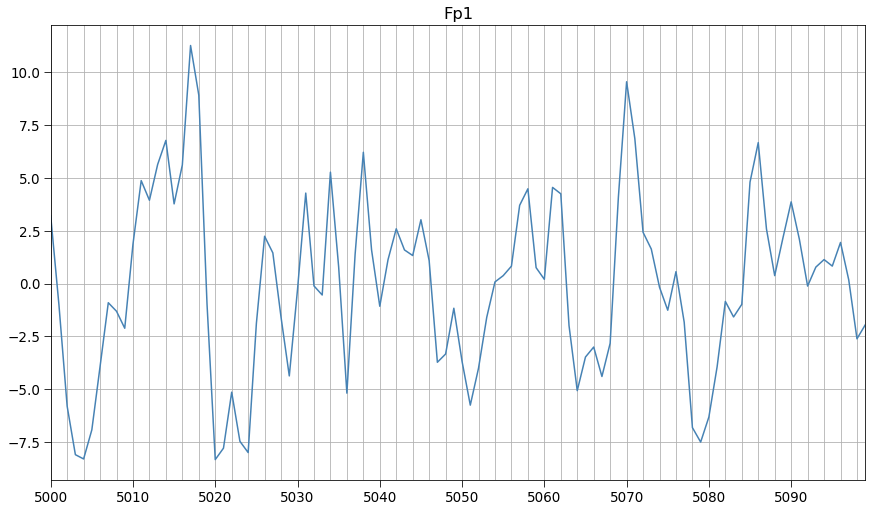

<IPython.core.display.Javascript object>

In [147]:
plot_ts(ts[5000:5100])

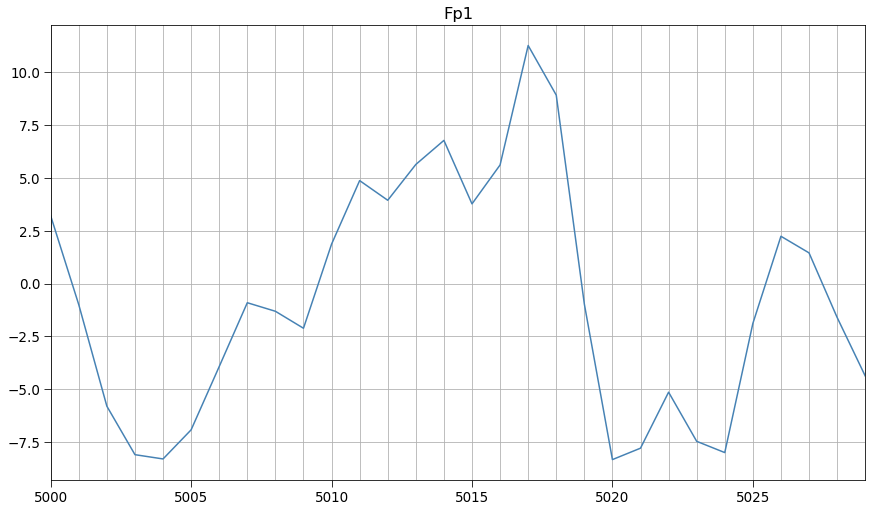

<IPython.core.display.Javascript object>

In [14]:
plot_ts(ts[5000:5030])

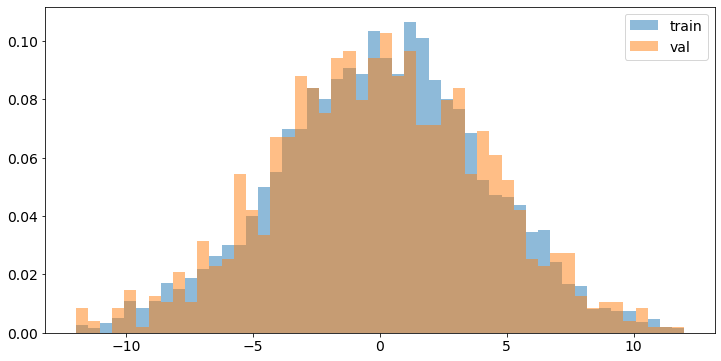

<IPython.core.display.Javascript object>

In [18]:
fig = plot_hist(
    train_intv.view(ts), bins=50, range=(-12, 12), density=True, name="train"
)
display(
    plot_hist(
        val_intv.view(ts),
        bins=50,
        range=(-12, 12),
        density=True,
        name="val",
        fig=fig,
    )
)

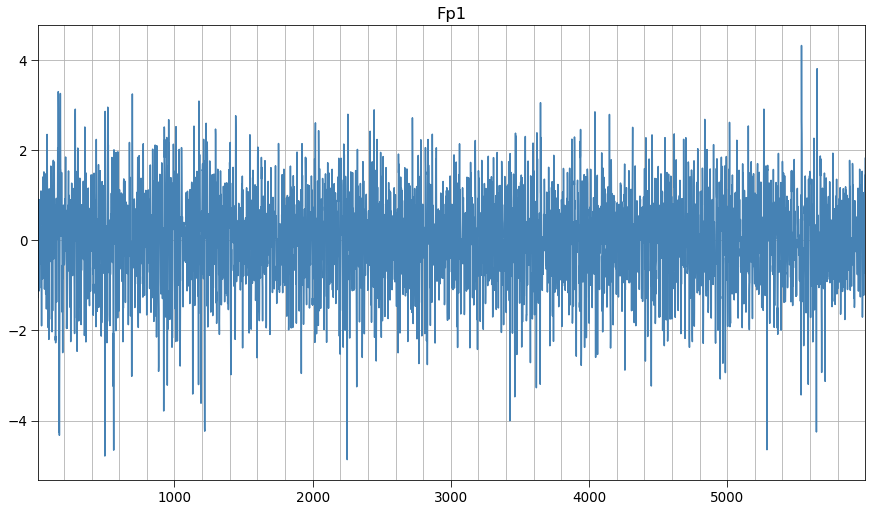

<IPython.core.display.Javascript object>

In [148]:
trans = IHSTransformer(train_intv.view(ts), save_loglikelihood_deriv=True)
trans_ts = trans.transform(ts)
display(plot_ts(train_intv.view(trans_ts)))

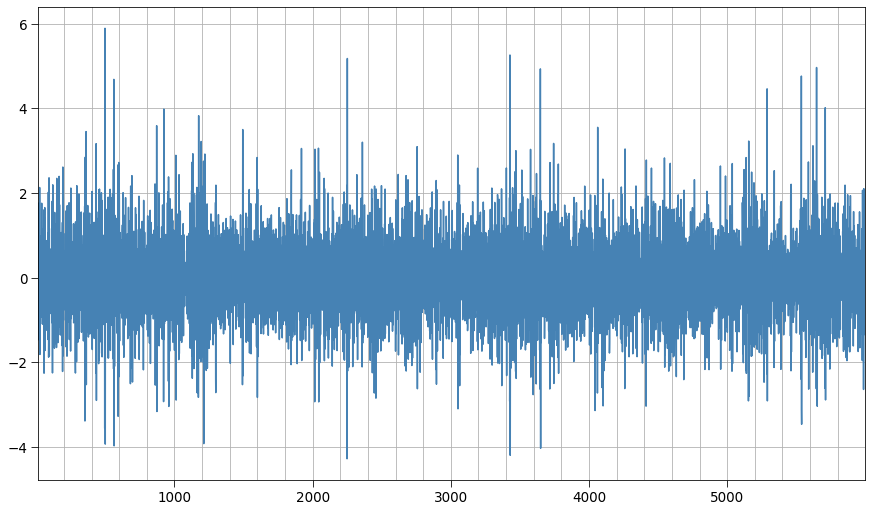

<IPython.core.display.Javascript object>

In [153]:
trans = IHSTransformer(train_intv.view(ts), d=2, save_loglikelihood_deriv=True)
trans_ts = trans.transform(ts)
display(plot_ts(train_intv.view(trans_ts)))

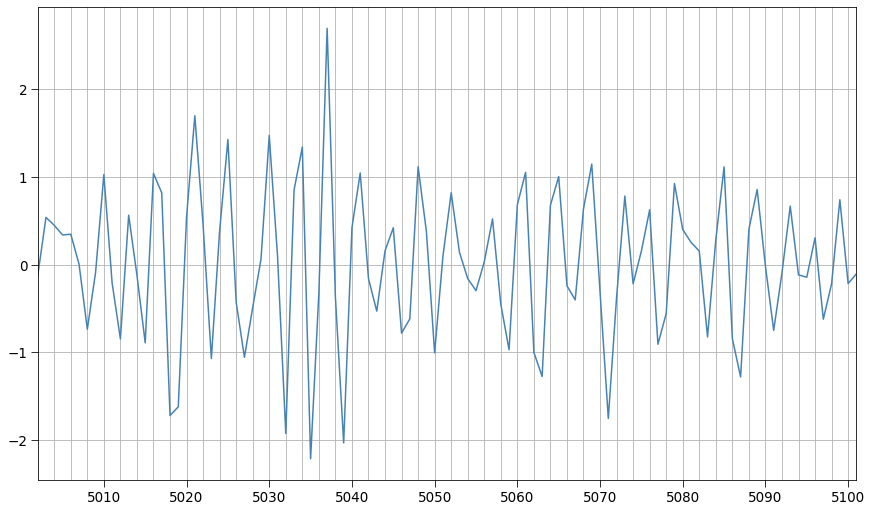

<IPython.core.display.Javascript object>

In [154]:
plot_ts(trans_ts[5000:5100])

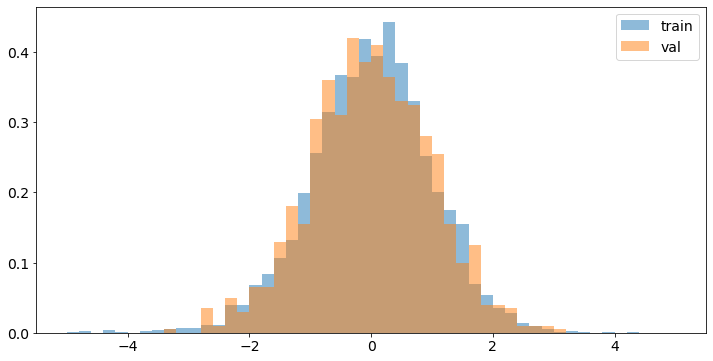

<IPython.core.display.Javascript object>

In [20]:
fig = plot_hist(
    train_intv.view(trans_ts), bins=50, range=(-5, 5), density=True, name="train"
)
display(
    plot_hist(
        val_intv.view(trans_ts),
        bins=50,
        range=(-5, 5),
        density=True,
        name="val",
        fig=fig,
    )
)

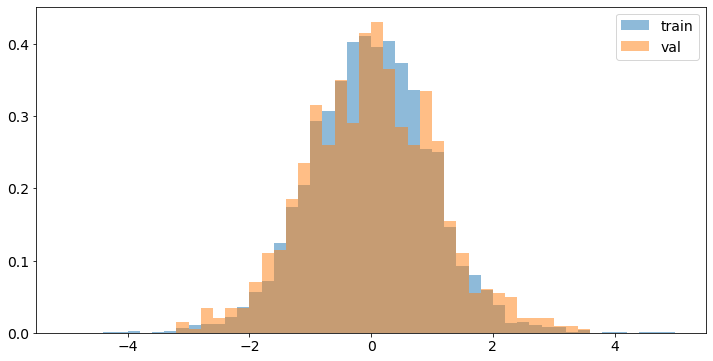

<IPython.core.display.Javascript object>

In [155]:
fig = plot_hist(
    train_intv.view(trans_ts), bins=50, range=(-5, 5), density=True, name="train"
)
display(
    plot_hist(
        val_intv.view(trans_ts),
        bins=50,
        range=(-5, 5),
        density=True,
        name="val",
        fig=fig,
    )
)

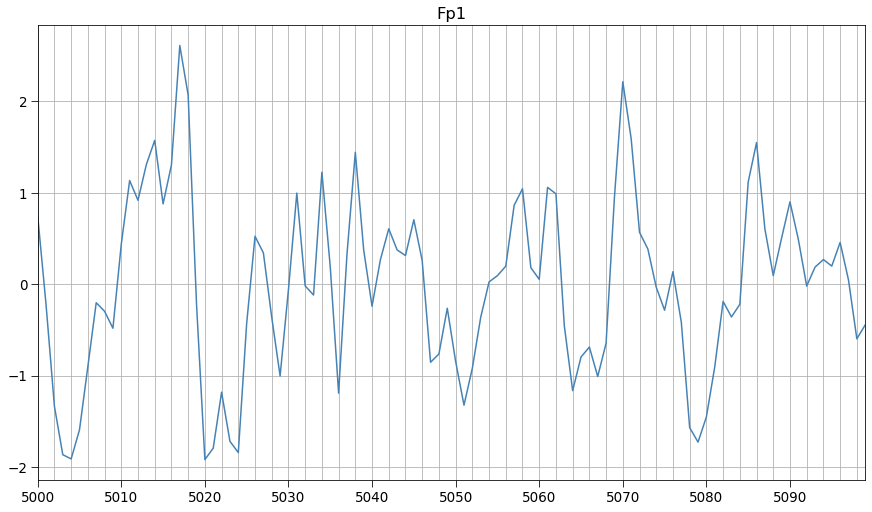

<IPython.core.display.Javascript object>

In [21]:
plot_ts(trans_ts[5000:5100])

#### SARIMA for EEG: Fp1

In [48]:
model_name = "SARIMA"
model_version = "0.0.1"

<IPython.core.display.Javascript object>

In [23]:
sarima_train_intv = train_intv
hyper_search_train_intv = tss.Interval(ts, 10, 400)
hyper_search_val_intv = tss.Interval(ts, 400, 700)

<IPython.core.display.Javascript object>

In [24]:
score_params = dict(
    scorings=["mae"],
    trans=trans,
    original_ts=ts,
    n_steps=pred_steps,
    n_steps_jump=20,
    mute=True,
)

<IPython.core.display.Javascript object>

In [25]:
fit_params = dict(scoring="mae")

<IPython.core.display.Javascript object>

In [27]:
%%time
p_range = list(np.arange(0, 5)) + list(np.arange(5, 13, 2))
q_range = list(np.arange(0, 5)) + list(np.arange(5, 17, 2))
s_range = np.arange(0, 60, 10)
grid = make_grid(p=p_range, q=q_range, s=s_range)
# grid = [params for params in grid if params["p"] * params["q"] <= 120]

model_params=dict(d=0)

sarima_grid_search_scores = sarima_grid_search()
    
pprint(sarima_grid_search_scores)

153/594, best_score: 3.236827, valuation: {'p': 1, 'q': 7, 's': 0}   
Terminating: more than 20 fails

[(3.236827148184083, {'p': 1, 'q': 7, 's': 0}),
 (3.236827148184083, {'p': 1, 'q': 7, 's': 10}),
 (3.236827148184083, {'p': 1, 'q': 7, 's': 20}),
 (3.236827148184083, {'p': 1, 'q': 7, 's': 30}),
 (3.236827148184083, {'p': 1, 'q': 7, 's': 40}),
 (3.236827148184083, {'p': 1, 'q': 7, 's': 50}),
 (3.2618364325846447, {'p': 1, 'q': 3, 's': 0}),
 (3.2618364325846447, {'p': 1, 'q': 3, 's': 10}),
 (3.2618364325846447, {'p': 1, 'q': 3, 's': 20}),
 (3.2618364325846447, {'p': 1, 'q': 3, 's': 30})]
CPU times: user 39min 52s, sys: 28min 57s, total: 1h 8min 50s
Wall time: 23min 53s


<IPython.core.display.Javascript object>

In [28]:
%%time
p_range = list(np.arange(0, 15))
q_range = list(np.arange(0, 15))
grid = make_grid(p=p_range, q=q_range)
grid = [params for params in grid if params["p"] * params["q"] <= 200]

model_params=dict(d=0)

sarima_grid_search_scores = sarima_grid_search(sarima_grid_search_scores)
    
pprint(sarima_grid_search_scores)

225/225, best_score: 3.139317, valuation: {'p': 2, 'q': 6}   
[(3.1393169503438827, {'p': 2, 'q': 6}),
 (3.185033913296052, {'p': 6, 'q': 8}),
 (3.1957503857894562, {'p': 10, 'q': 13}),
 (3.2194889686187986, {'p': 8, 'q': 11}),
 (3.2219681543749843, {'p': 8, 'q': 12}),
 (3.2362193223355304, {'p': 2, 'q': 5}),
 (3.236827148184083, {'p': 1, 'q': 7, 's': 0}),
 (3.236827148184083, {'p': 1, 'q': 7, 's': 10}),
 (3.236827148184083, {'p': 1, 'q': 7, 's': 20}),
 (3.236827148184083, {'p': 1, 'q': 7, 's': 30})]
CPU times: user 2h 9min 12s, sys: 1h 33min 5s, total: 3h 42min 17s
Wall time: 1h 5min 7s


<IPython.core.display.Javascript object>

In [49]:
%%time
sarima_model = SarimaModel(p=2, d=0, q=6)
sarima_model.fit(trans_ts, sarima_train_intv)

CPU times: user 1min 13s, sys: 50.9 s, total: 2min 4s
Wall time: 35.2 s


<IPython.core.display.Javascript object>

In [50]:
%%time
pprint(average_scores(sarima_model, trans_ts, val_intv, scorings=scorings,
                      trans=trans, original_ts=ts,
                      n_steps=pred_steps, n_steps_jump=pred_jump))

139/139 – MAE: 3.43042, MASE: 1.15083, sMAPE: 132.17887, elapsed time: 22min 8s (last: 10.8s)       
{'MAE': 3.4304181462064616,
 'MASE': 1.150832988244202,
 'sMAPE': 132.17887158108798}
CPU times: user 48min 2s, sys: 33min 24s, total: 1h 21min 26s
Wall time: 22min 8s


<IPython.core.display.Javascript object>

In [51]:
%%time
sarima_model.update(trans_ts, val_intv)
sarima_test_mean_scores, sarima_test_all_scores, sarima_test_preds = average_scores(
    sarima_model,
    trans_ts,
    test_intv,
    scorings=scorings,
    trans=trans,
    original_ts=ts,
    n_steps=pred_steps,
    n_steps_jump=pred_jump,
    return_all_scores=True,
    return_preds=True
)
save_model_scores_and_preds(
    data_type, data_name, model_name, sarima_test_mean_scores, sarima_test_preds
)
pprint(sarima_test_mean_scores)

148/148 – MAE: 3.43979, MASE: 1.16004, sMAPE: 134.60149, elapsed time: 28min 40s (last: 11.6s)      
{'MAE': 3.439794371381005,
 'MASE': 1.1600407760896743,
 'sMAPE': 134.6014902456242}
CPU times: user 59min 33s, sys: 40min 49s, total: 1h 40min 23s
Wall time: 28min 53s


<IPython.core.display.Javascript object>

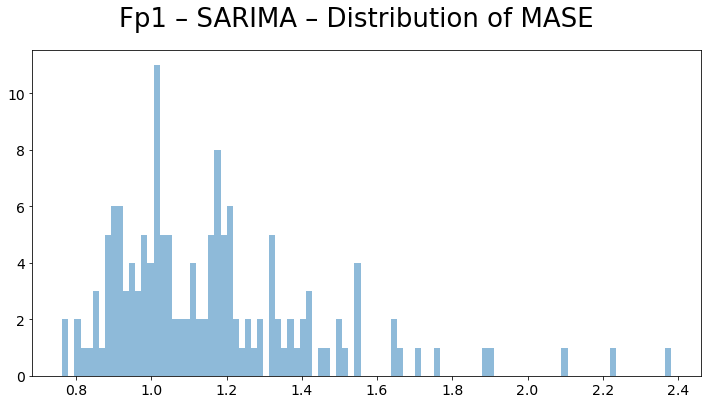

<IPython.core.display.Javascript object>

In [52]:
display(plot_hist_model_scores(data_name, model_name, sarima_test_all_scores, "MASE"))

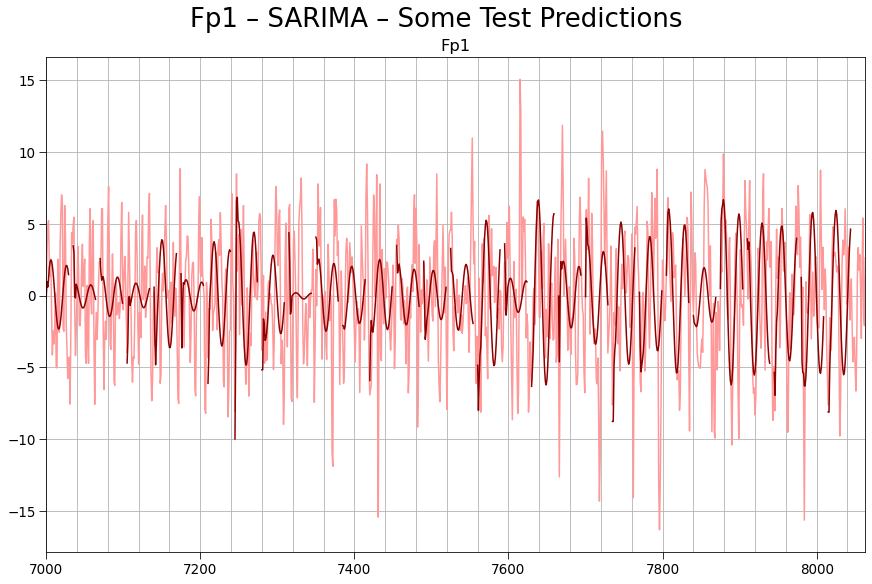

<IPython.core.display.Javascript object>

In [53]:
fig_time_delta = 0
fig = plot_ground_truth(test_intv, model_name=model_name, data_name=data_name)
display(
    plot_model_test_prediction(test_intv, fig_time_delta, sarima_test_preds, fig=fig)
)

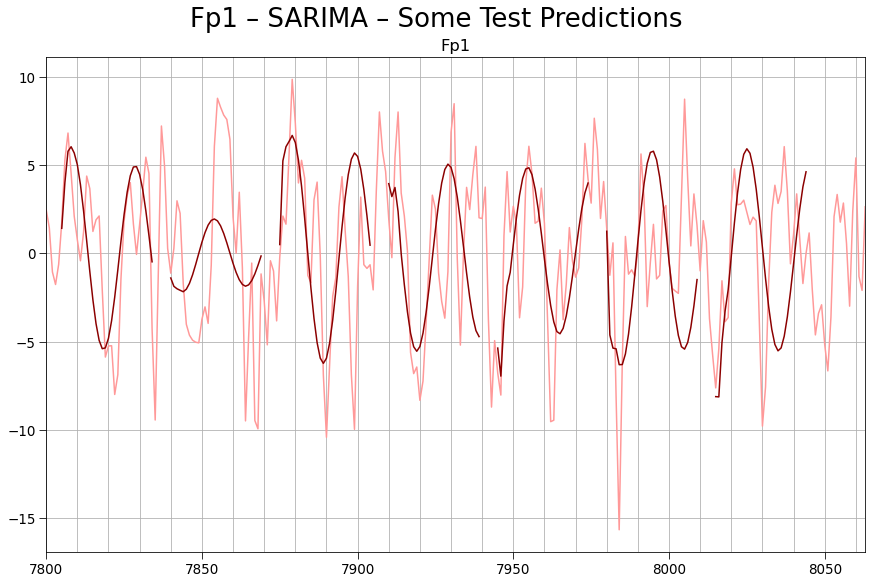

<IPython.core.display.Javascript object>

In [54]:
fig_time_delta = 0
short_test_intv = tss.Interval(ts, 7800)
fig = plot_ground_truth(short_test_intv, model_name=model_name, data_name=data_name)
display(
    plot_model_test_prediction(
        short_test_intv, fig_time_delta, sarima_test_preds, fig=fig
    )
)

## Website Visits: Page Loads

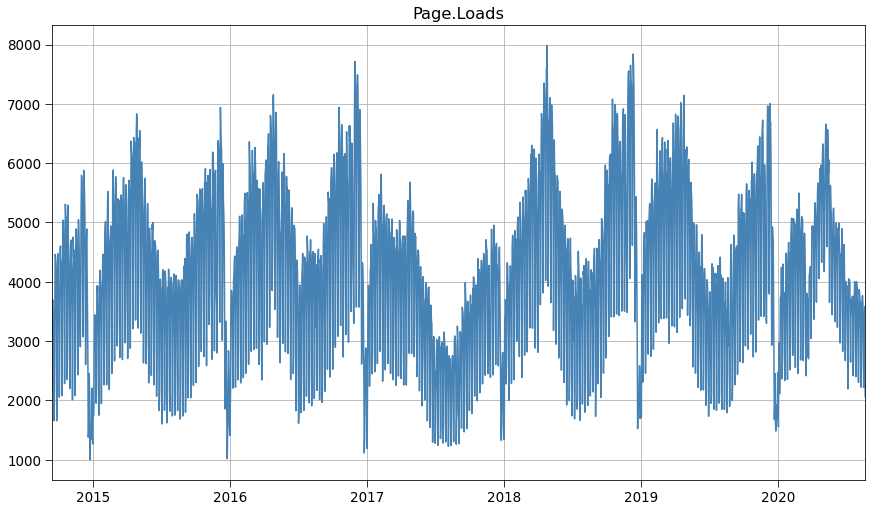

<IPython.core.display.Javascript object>

In [11]:
website_data = pd.read_csv("data/daily-website-visitors.csv")
website_data["Date"] = pd.to_datetime(website_data["Date"], format="%m/%d/%Y")
website_data.set_index("Date", inplace=True)
website_data.sort_index(ascending=True, inplace=True)
for col in website_data.columns:
    if col not in {"Row", "Day", "Day.Of.Week"}:
        website_data[col] = website_data[col].apply(lambda s: int(s.replace(",", "")))
data_type = "Website Visits"
data_name = "Page Loads"
ts = website_data["Page.Loads"]
display(plot_ts(ts))

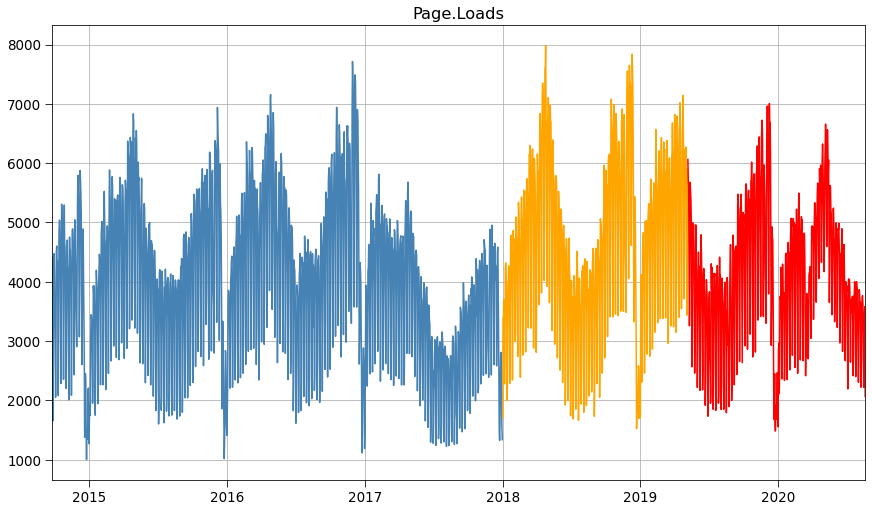

<IPython.core.display.Javascript object>

In [13]:
train_datetime = ts.index[10]
test_datetime = datetime(2019, 5, 7)  # Monday
val_datetime = datetime(2018, 1, 1)  # Monday
train_intv = tss.Interval(ts, train_datetime, val_datetime)
val_intv = tss.Interval(ts, val_datetime, test_datetime)
test_intv = tss.Interval(ts, test_datetime)
fig = plot_ts(train_intv.view())
plot_ts(val_intv.view(), fig=fig, color="orange")
display(plot_ts(test_intv.view(), fig=fig, color="red"))

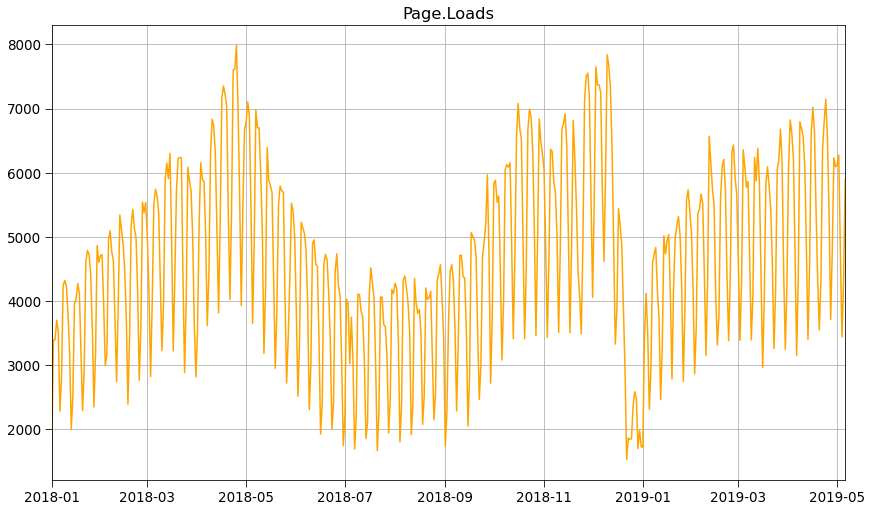

<IPython.core.display.Javascript object>

In [72]:
display(plot_ts(val_intv.view(), color="orange"))

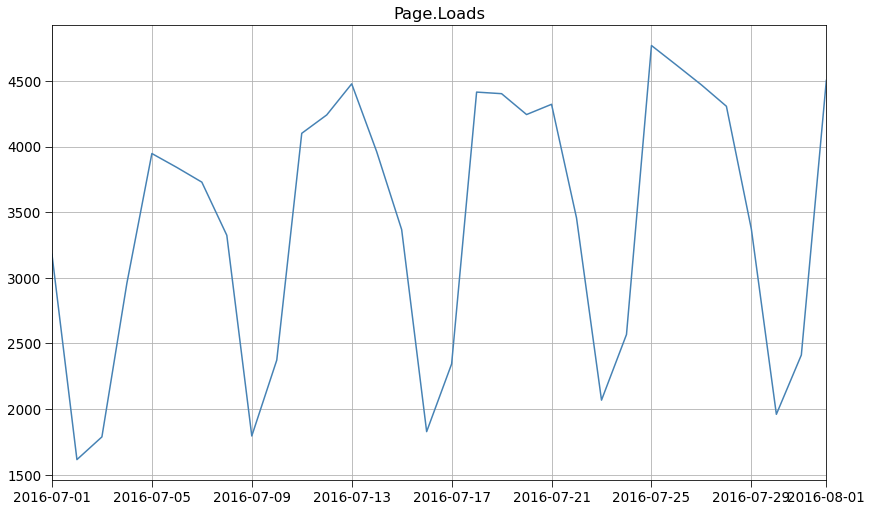

<IPython.core.display.Javascript object>

In [73]:
plot_ts(ts[datetime(2016, 7, 1) : datetime(2016, 8, 1)])

Order of differencing: 1
MLE of IHS lambda cannot be found


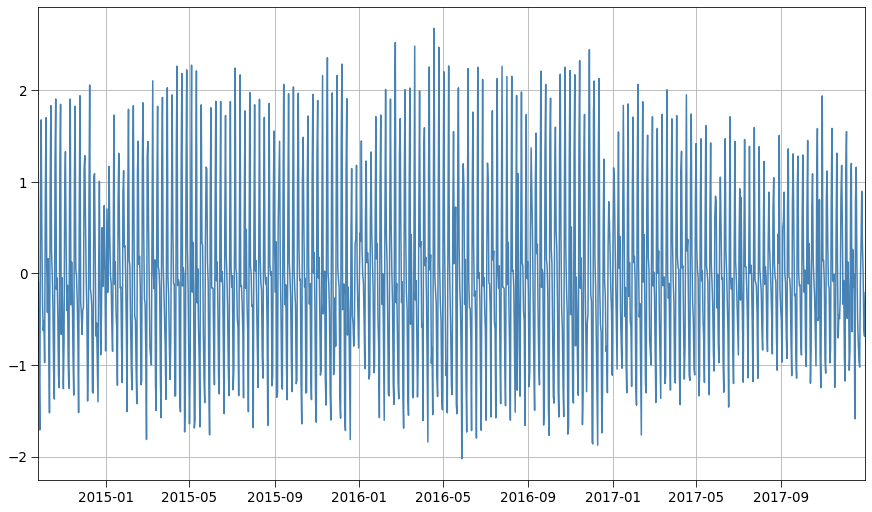

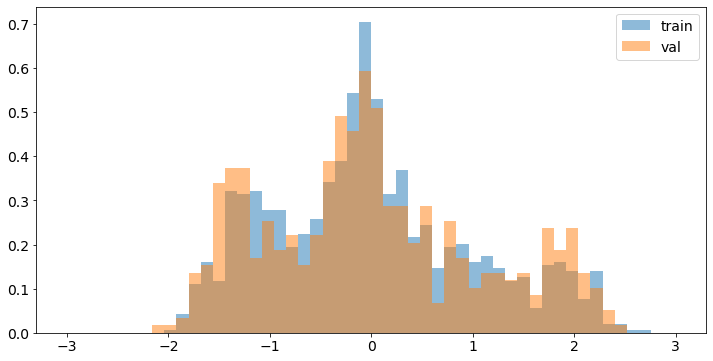

<IPython.core.display.Javascript object>

In [14]:
trans = IHSTransformer(
    train_intv.view(ts), verbose=True, save_loglikelihood_deriv=True
)
trans_ts = trans.transform(ts)
display(plot_ts(train_intv.view(trans_ts)))
fig = plot_hist(
    train_intv.view(trans_ts), bins=50, range=(-3, 3), density=True, name="train"
)
display(
    plot_hist(
        val_intv.view(trans_ts),
        bins=50,
        range=(-3, 3),
        density=True,
        name="val",
        fig=fig,
    )
)

In [12]:
trans = IHSTransformer(
    train_intv.view(ts), d=1, verbose=True, save_loglikelihood_deriv=True
)
trans_ts = trans.transform(ts)
display(plot_ts(train_intv.view(trans_ts)))
fig = plot_hist(
    train_intv.view(trans_ts), bins=50, range=(-3, 3), density=True, name="train"
)
display(
    plot_hist(
        val_intv.view(trans_ts),
        bins=50,
        range=(-3, 3),
        density=True,
        name="val",
        fig=fig,
    )
)

NameError: name 'train_intv' is not defined

<IPython.core.display.Javascript object>

Order of differencing: 1
MLE of IHS lambda cannot be found


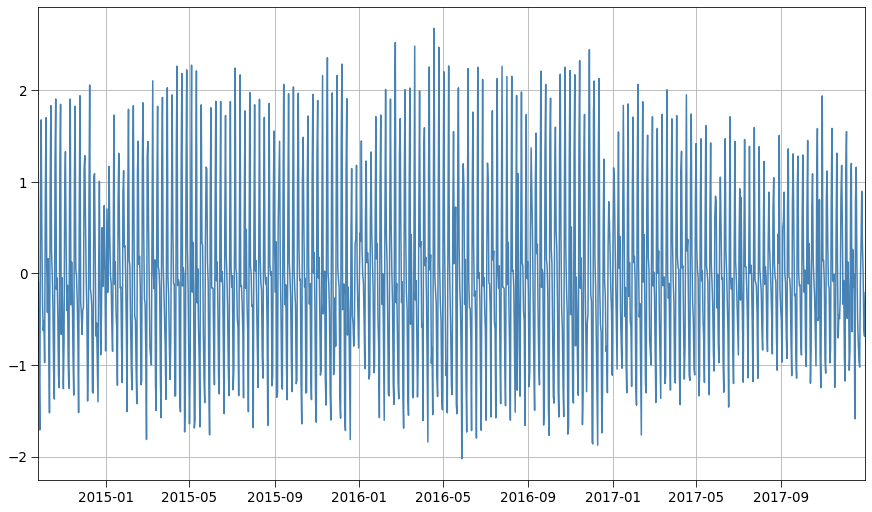

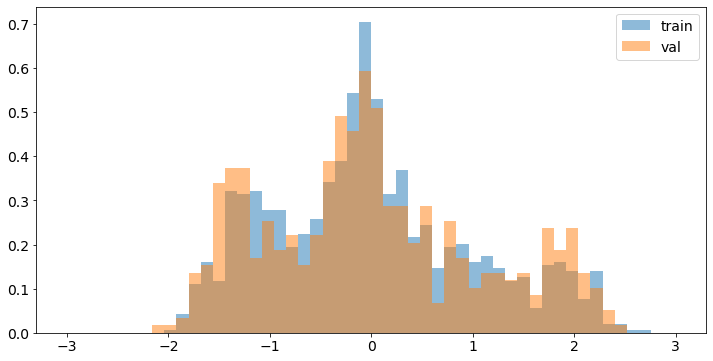

<IPython.core.display.Javascript object>

In [79]:
trans1 = IHSTransformer(
    train_intv.view(trans_ts), verbose=True, save_loglikelihood_deriv=True
)
trans_ts1 = trans1.transform(trans_ts)
display(plot_ts(train_intv.view(trans_ts1)))
fig = plot_hist(
    train_intv.view(trans_ts1), bins=50, range=(-3, 3), density=True, name="train"
)
display(
    plot_hist(
        val_intv.view(trans_ts1),
        bins=50,
        range=(-3, 3),
        density=True,
        name="val",
        fig=fig,
    )
)

#### SARIMA for Page Loads

In [256]:
model_name = "SARIMA"
model_version = "0.0.1"

<IPython.core.display.Javascript object>

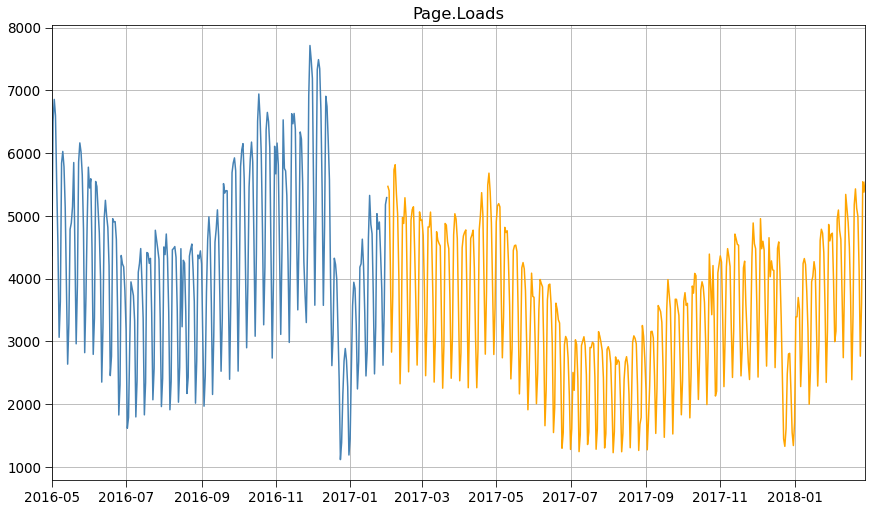

<IPython.core.display.Javascript object>

In [34]:
sarima_hyper_search_train_intv = tss.Interval(
    ts, datetime(2016, 5, 1), datetime(2017, 2, 1)
)
sarima_hyper_search_val_intv = tss.Interval(
    ts, datetime(2017, 2, 1), datetime(2018, 3, 1)
)
fig = plot_ts(sarima_hyper_search_train_intv.view())
display(plot_ts(sarima_hyper_search_val_intv.view(), color="orange", fig=fig))

In [48]:
score_params = dict(
    scorings=["mae"],
    trans=trans,
    original_ts=ts,
    n_steps=pred_steps,
    n_steps_jump=5,
    mute=True,
)

fit_params=dict(scoring="mse")

model_params = dict(d=0, D=1)

<IPython.core.display.Javascript object>

In [31]:
%%time
p_range = [0, 1, 2, 3, 4, 5, 10]
q_range = [0, 1, 2, 3, 4, 5, 10]
s_range = [7, 14, 21, 28]
grid = make_grid(p=p_range, q=q_range, s=s_range)
grid = [params for params in grid if params["p"] * params["q"] * params["s"] <= 64]

sarima_grid_search_scores = sarima_grid_search()
    
pprint(sarima_grid_search_scores)

83/83, best_score: 275.621951, valuation: {'p': 0, 'q': 10, 's': 7}   
[(275.62195115813836, {'p': 0, 'q': 10, 's': 7}),
 (295.05289946210576, {'p': 4, 'q': 1, 's': 7}),
 (299.3313523596582, {'p': 3, 'q': 2, 's': 7}),
 (300.06540369528466, {'p': 1, 'q': 1, 's': 7}),
 (300.4595553832342, {'p': 2, 'q': 3, 's': 7}),
 (301.21769669999907, {'p': 3, 'q': 3, 's': 7}),
 (307.84108963495174, {'p': 4, 'q': 2, 's': 7}),
 (321.7148726875239, {'p': 10, 'q': 0, 's': 7}),
 (335.6237280357888, {'p': 0, 'q': 5, 's': 7}),
 (348.38846810708634, {'p': 1, 'q': 5, 's': 7})]
CPU times: user 1h 38min, sys: 1h 2min 12s, total: 2h 40min 13s
Wall time: 46min 52s


<IPython.core.display.Javascript object>

In [43]:
%%time
p_range = [0, 1, 2, 3, 4, 5, 7, 10, 15, 20]
q_range = [0, 1, 2, 3, 4, 5, 7, 10, 15, 20]
grid = make_grid(p=p_range, q=q_range)
grid = [params for params in grid if params["p"] * params["q"] <= 120]

model_params = dict(d=0)

sarima_grid_search_scores = sarima_grid_search(scores=sarima_grid_search_scores)

pprint(sarima_grid_search_scores)

90/90, best_score: 267.672543, valuation: {'p': 7, 'q': 5}    
[(267.67254273730964, {'p': 7, 'q': 5}),
 (269.53938475820274, {'p': 5, 'q': 10}),
 (269.99776091940777, {'p': 5, 'q': 7}),
 (270.42687014009124, {'p': 4, 'q': 7}),
 (271.01529970981215, {'p': 4, 'q': 5}),
 (271.4767188528469, {'p': 7, 'q': 7}),
 (271.5328694855348, {'p': 4, 'q': 10}),
 (271.81601229049437, {'p': 5, 'q': 4}),
 (273.8165413265552, {'p': 10, 'q': 7}),
 (274.64492748780333, {'p': 10, 'q': 10})]
CPU times: user 2h 33min 32s, sys: 1h 48min 36s, total: 4h 22min 8s
Wall time: 1h 9min 22s


<IPython.core.display.Javascript object>

In [46]:
%%time
p_range = range(1,15)
q_range = range(1,15)
D_range = [0, 1]
grid = make_grid(p=p_range, q=q_range, D=D_range)
grid = [params for params in grid if params["p"] * params["q"] <= 300]

model_params = dict(d=0, s=7)

sarima_grid_search_scores = sarima_grid_search(scores=sarima_grid_search_scores)
    
pprint(sarima_grid_search_scores)

392/392, best_score: 265.181927, valuation: {'p': 7, 'q': 6, 'D': 0}    
[(265.1819273894884, {'D': 0, 'p': 7, 'q': 6}),
 (266.262221212223, {'D': 0, 'p': 8, 'q': 6}),
 (267.67254273730964, {'p': 7, 'q': 5}),
 (267.67254273730964, {'D': 0, 'p': 7, 'q': 5}),
 (267.82777790121656, {'D': 0, 'p': 6, 'q': 11}),
 (268.84756522602294, {'D': 0, 'p': 6, 'q': 9}),
 (269.0265743126988, {'D': 0, 'p': 6, 'q': 7}),
 (269.4804834251493, {'D': 0, 'p': 6, 'q': 5}),
 (269.53938475820274, {'p': 5, 'q': 10}),
 (269.53938475820274, {'D': 0, 'p': 5, 'q': 10})]
CPU times: user 15h 17min 22s, sys: 10h 50min 3s, total: 1d 2h 7min 26s
Wall time: 7h 4min 21s


<IPython.core.display.Javascript object>

In [47]:
%%time
sarima_model = SarimaModel(p=7, d=0, q=6, s=7, D=0, max_ts_len=800, retrain_ts_len=700)
sarima_model.fit(trans_ts, train_intv)

CPU times: user 19.7 s, sys: 13.8 s, total: 33.5 s
Wall time: 8.88 s


<IPython.core.display.Javascript object>

In [48]:
%%time
pprint(average_scores(sarima_model, trans_ts, val_intv, scorings=scorings,
                      trans=trans, original_ts=ts,
                      n_steps=pred_steps, n_steps_jump=pred_jump))

121/121 – MAE: 386.56439, MASE: 0.51144, sMAPE: 9.55344, elapsed time: 1min 7s (last: 0.6s)      
{'MAE': 386.5643948349972, 'MASE': 0.5114404165303478, 'sMAPE': 9.5534438680134}
CPU times: user 2min 29s, sys: 1min 47s, total: 4min 17s
Wall time: 1min 7s


<IPython.core.display.Javascript object>

In [49]:
%%time
sarima_model.update(trans_ts, val_intv)
sarima_test_mean_scores, sarima_test_all_scores, sarima_test_preds = average_scores(
    sarima_model,
    trans_ts,
    test_intv,
    scorings=scorings,
    trans=trans,
    original_ts=ts,
    n_steps=pred_steps,
    n_steps_jump=pred_jump,
    return_all_scores=True,
    return_preds=True
)
save_model_scores_and_preds(
    data_type, data_name, model_name, sarima_test_mean_scores, sarima_test_preds
)
pprint(sarima_test_mean_scores)

116/116 – MAE: 357.78913, MASE: 0.59435, sMAPE: 10.03213, elapsed time: 1min 4s (last: 0.5s)      
{'MAE': 357.78913209190927,
 'MASE': 0.5943544325129202,
 'sMAPE': 10.032128780857901}
CPU times: user 2min 23s, sys: 1min 42s, total: 4min 5s
Wall time: 1min 5s


<IPython.core.display.Javascript object>

In [ ]:
display(plot_hist_model_scores(data_name, model_name, sarima_test_all_scores, "MASE"))

In [ ]:
fig_time_delta = timedelta(hours=17)
fig = plot_ground_truth(model_name, data_name, test_intv)
display(plot_model_test_prediction(test_intv, fig_time_delta, sarima_test_preds, fig=fig))

In [ ]:
fig_time_delta = timedelta(hours=17)
fig = plot_ground_truth(model_name, data_name, short_test_intv)
display(plot_model_test_prediction(short_test_intv, fig_time_delta, sarima_test_preds, fig=fig))

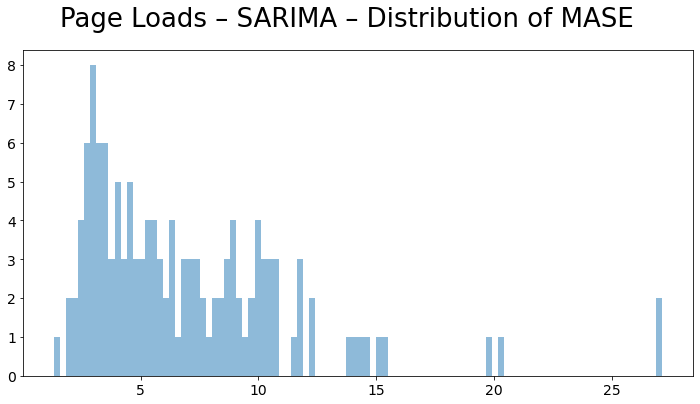

<IPython.core.display.Javascript object>

In [259]:
scoring_name = "MASE"
display(plot_hist_model_scores(sarima_test_all_scores))

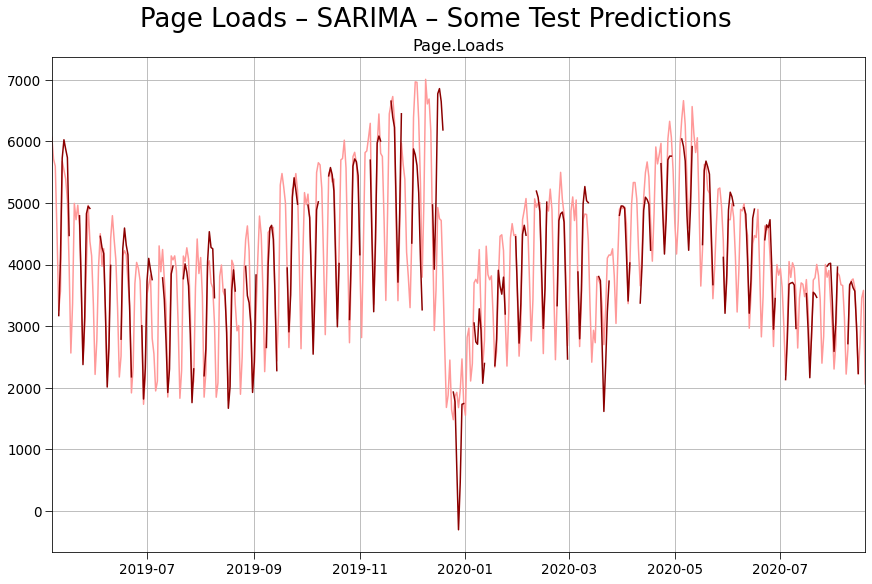

<IPython.core.display.Javascript object>

In [260]:
fig = plot_ground_truth()
display(plot_model_test_prediction(sarima_test_preds, fig=fig))

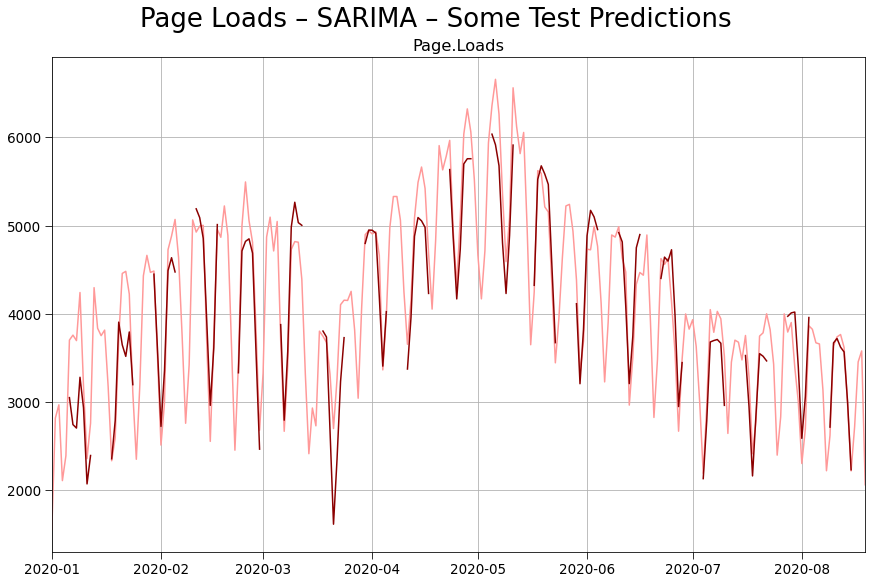

<IPython.core.display.Javascript object>

In [261]:
fig = plot_ground_truth(test_intv=short_test_intv)
display(
    plot_model_test_prediction(sarima_test_preds, fig=fig, test_intv=short_test_intv)
)

## Weather

In [20]:
data_type = "Weather"
data_name = "Humidity"
ts = ts_data[data_type][data_name]
train_datetime = datetime(2013, 1, 1)
test_datetime = datetime(2016, 8, 1)
val_datetime = datetime(2015, 12, 1)
train_intv = tss.Interval(ts, train_datetime, val_datetime)
val_intv = tss.Interval(ts, val_datetime, test_datetime)
test_intv = tss.Interval(ts, test_datetime)
fig = plot_ts(train_intv.view(), engine="plotly")
plot_ts(val_intv.view(), fig=fig, color="orange")
display(plot_ts(test_intv.view(), fig=fig, color="red"))

<IPython.core.display.Javascript object>

In [21]:
display(plot_ts(val_intv.view(), color="orange", engine="plotly"))

<IPython.core.display.Javascript object>

In [22]:
begin_datetime = datetime(2015, 8, 1)
end_datetime = begin_datetime + timedelta(days=7)
pred_steps = 24  # 24 hour
pred_jump = 5  # 5 hours
display(
    plot_ts(train_intv.view(begin=begin_datetime, end=end_datetime), engine="plotly")
)

<IPython.core.display.Javascript object>

In [23]:
trans = IHSTransformer(train_intv.view())
trans_ts = trans.transform(ts)
display(plot_ts(train_intv.view(trans_ts), engine="plotly"))

<IPython.core.display.Javascript object>

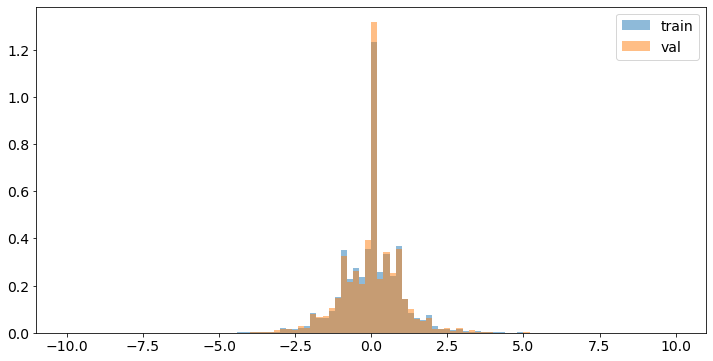

<IPython.core.display.Javascript object>

In [24]:
fig = plot_hist(
    train_intv.view(trans_ts), bins=100, range=(-10, 10), density=True, name="train"
)
display(
    plot_hist(
        val_intv.view(trans_ts),
        bins=100,
        range=(-10, 10),
        density=True,
        name="val",
        fig=fig,
    )
)

### Wind Speed

In [8]:
weather_data["Formatted Date"] = pd.to_datetime(
    weather_data["Formatted Date"].apply(lambda s: s[:-10])
)
weather_data.set_index("Formatted Date", inplace=True)
weather_data.sort_index(inplace=True)

NameError: name 'weather_data' is not defined

<IPython.core.display.Javascript object>

In [10]:
ts = weather_data["Wind Speed (km/h)"][: datetime(2016, 11, 1)]

<IPython.core.display.Javascript object>

In [11]:
plot_ts(ts, engine="plotly")

<IPython.core.display.Javascript object>

In [12]:
plot_ts(ts[:datetime(2007, 1, 1)], engine="plotly")

<IPython.core.display.Javascript object>

In [71]:
ts.skew()

1.1065860257463684

<IPython.core.display.Javascript object>

In [72]:
trans_ts0.skew()

-0.14374108856921772

<IPython.core.display.Javascript object>

MLE of IHS lambda: 1.931250e-01


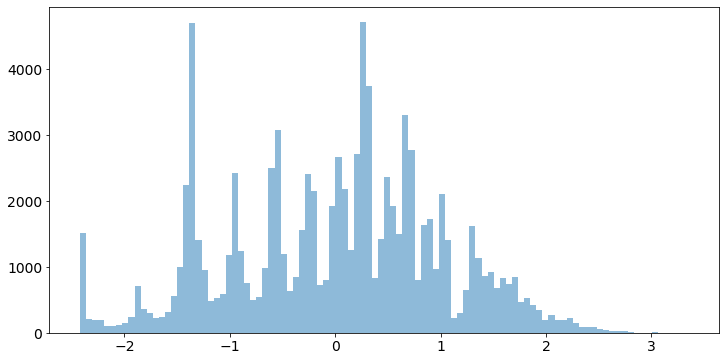

<IPython.core.display.Javascript object>

In [70]:
trans0 = IHSTransformer(
    ts, transform_train_intv, d=0, verbose=True, save_loglikelihood_deriv=True
)
trans_ts0 = trans0.transform(ts)
plot_hist(trans_ts0)

In [23]:
transform_train_intv = tss.Interval(ts, end=datetime(2009, 1, 1))
transform_train_intv.view().size

26304

<IPython.core.display.Javascript object>

In [24]:
transform_train_intv.view().skew()

1.2021116980056308

<IPython.core.display.Javascript object>

In [25]:
ts.skew()

1.1065860257463684

<IPython.core.display.Javascript object>

Order of differencing: 1
MLE of IHS lambda: 2.350000e-01


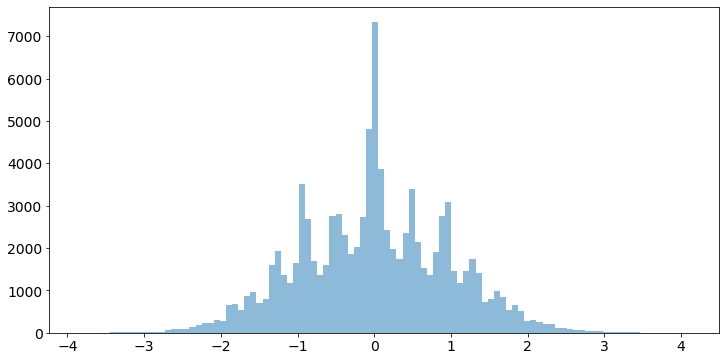

<IPython.core.display.Javascript object>

In [49]:
trans = IHSTransformer(
    ts, transform_train_intv, verbose=True, save_loglikelihood_deriv=True
)
trans_ts = trans.transform(ts)
plot_hist(trans_ts)

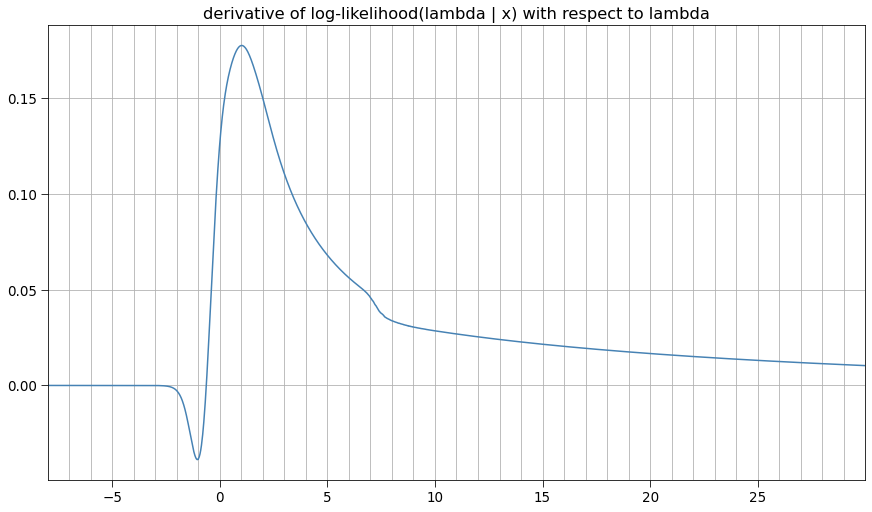

<IPython.core.display.Javascript object>

In [32]:
plot_ts(trans.loglikelihood_deriv)

In [50]:
trans_ts.skew()

0.031671443836791546

<IPython.core.display.Javascript object>

Order of differencing: 1


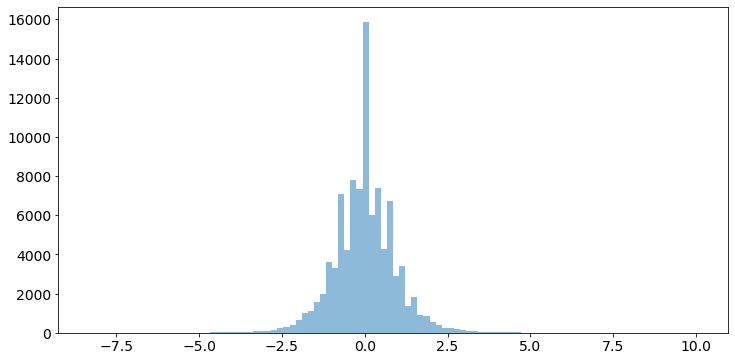

<IPython.core.display.Javascript object>

In [48]:
ordinary_trans = IHSTransformer(ts, transform_train_intv, lmb=None, verbose=True)
ordinary_trans_ts = ordinary_trans.transform(ts)
plot_hist(ordinary_trans_ts)

In [51]:
ordinary_trans_ts.skew()

0.15023070138514186

<IPython.core.display.Javascript object>

In [59]:
fig = plot_ts(ordinary_trans_ts[:1000], name="ordinary", color="blue", engine="plotly")
plot_ts(
    trans_ts[:1000],
    color="tab:orange",
    name="IHS",
    fig=fig,
)
display(fig)

<IPython.core.display.Javascript object>

In [65]:
trans_ts.mean()

0.0006469788768249225

<IPython.core.display.Javascript object>

In [68]:
ordinary_trans_ts.mean()

0.00010453670920720433

<IPython.core.display.Javascript object>

In [66]:
trans_ts.std()

0.972840710847982

<IPython.core.display.Javascript object>

In [69]:
ordinary_trans_ts.std()

0.9499375968082755

<IPython.core.display.Javascript object>

In [64]:
plot_ts(trans_ts - ordinary_trans_ts, engine="plotly")

<IPython.core.display.Javascript object>

## Covid-19: Daily New Cases in Argentina

In [1]:
data_type = "Covid-19"
data_name = "Argentina"
ts = ts_data[data_type][data_name]
train_datetime = ts.index[10]
test_datetime = datetime(2021, 5, 1)
val_datetime = datetime(2021, 4, 1)
train_intv = tss.Interval(ts, train_datetime, val_datetime)
val_intv = tss.Interval(ts, val_datetime, test_datetime)
test_intv = tss.Interval(ts, test_datetime)
fig = plot_ts(train_intv.view())
plot_ts(val_intv.view(), fig=fig, color="orange")
display(plot_ts(test_intv.view(), fig=fig, color="red"))

NameError: name 'ts_data' is not defined

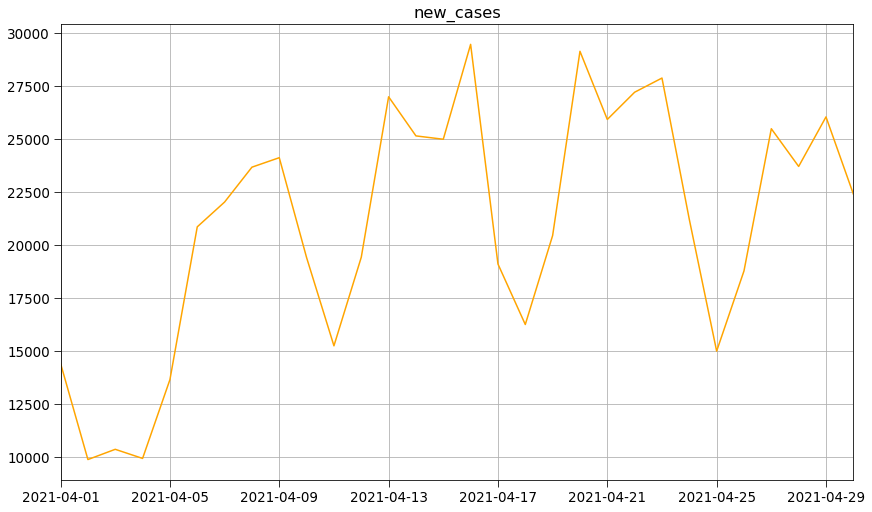

<IPython.core.display.Javascript object>

In [16]:
display(plot_ts(val_intv.view(), color="orange"))

In [109]:
pred_steps = 14  # 2 weeks
pred_jump = 1  # 1 day

<IPython.core.display.Javascript object>

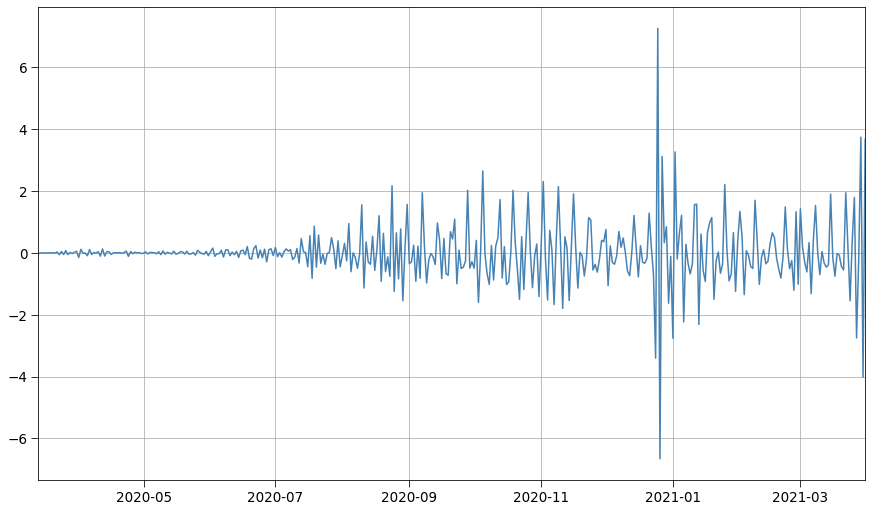

<IPython.core.display.Javascript object>

In [18]:
trans = IHSTransformer(train_intv.view(ts), d=2, save_loglikelihood_deriv=True)
trans_ts = trans.transform(ts)
display(plot_ts(train_intv.view(trans_ts)))

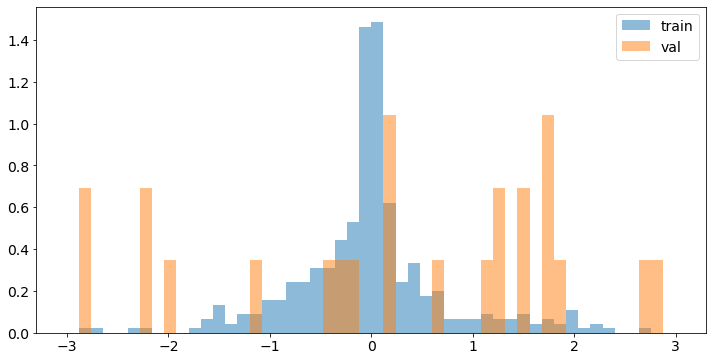

<IPython.core.display.Javascript object>

In [19]:
fig = plot_hist(
    train_intv.view(trans_ts), bins=50, range=(-3, 3), density=True, name="train"
)
display(
    plot_hist(
        val_intv.view(trans_ts),
        bins=50,
        range=(-3, 3),
        density=True,
        name="val",
        fig=fig,
    )
)

#### SARIMA for Covid-19 in Argentina

In [20]:
model_name = "SARIMA"
model_version = "0.0.1"

<IPython.core.display.Javascript object>

In [21]:
sarima_train_intv = tss.Interval(ts, train_intv.view().index[trans.d], train_intv.end)
hyper_search_train_intv = sarima_train_intv
hyper_search_val_intv = val_intv

<IPython.core.display.Javascript object>

In [22]:
score_params = dict(
    scorings=["mae"],
    trans=trans,
    original_ts=ts,
    n_steps=pred_steps,
    n_steps_jump=1,
    mute=True,
)

<IPython.core.display.Javascript object>

In [23]:
fit_params = dict(scoring="mae")

<IPython.core.display.Javascript object>

In [25]:
%%time
p_range = np.arange(0, 10)
q_range = np.arange(0, 15)
s_range = np.arange(1, 15)
grid = make_grid(p=p_range, q=q_range, s=s_range)
grid = [params for params in grid if params["p"] * params["q"] <= 120]

model_params=dict(d=0)

sarima_grid_search_scores = sarima_grid_search()
    
pprint(sarima_grid_search_scores)

2086/2086, best_score: 4685.754796, valuation: {'p': 8, 'q': 7, 's': 1}    
[(4685.754795856112, {'p': 8, 'q': 7, 's': 1}),
 (4685.754795856112, {'p': 8, 'q': 7, 's': 2}),
 (4685.754795856112, {'p': 8, 'q': 7, 's': 3}),
 (4685.754795856112, {'p': 8, 'q': 7, 's': 4}),
 (4685.754795856112, {'p': 8, 'q': 7, 's': 5}),
 (4685.754795856112, {'p': 8, 'q': 7, 's': 6}),
 (4685.754795856112, {'p': 8, 'q': 7, 's': 7}),
 (4685.754795856112, {'p': 8, 'q': 7, 's': 8}),
 (4685.754795856112, {'p': 8, 'q': 7, 's': 9}),
 (4685.754795856112, {'p': 8, 'q': 7, 's': 10})]
CPU times: user 11h 45min 48s, sys: 8h 22min 16s, total: 20h 8min 4s
Wall time: 5h 23min 2s


<IPython.core.display.Javascript object>

In [26]:
%%time
sarima_model = SarimaModel(p=8, d=0, q=7, s=1, D=0)
sarima_model.fit(trans_ts, sarima_train_intv)

CPU times: user 8.9 s, sys: 6.56 s, total: 15.5 s
Wall time: 4.26 s


<IPython.core.display.Javascript object>

In [27]:
%%time
pprint(average_scores(sarima_model, trans_ts, val_intv, scorings=scorings,
                      trans=trans, original_ts=ts,
                      n_steps=pred_steps, n_steps_jump=pred_jump))

16/16 – MAE: 4685.75480, MASE: 1.23619, sMAPE: 24.52304, elapsed time: 7.2s (last: 0.4s)      
{'MAE': 4685.754795856112,
 'MASE': 1.2361890238610271,
 'sMAPE': 24.52304413848971}
CPU times: user 14.5 s, sys: 11.2 s, total: 25.7 s
Wall time: 7.23 s


<IPython.core.display.Javascript object>

In [28]:
%%time
sarima_model.update(trans_ts, val_intv)
sarima_test_mean_scores, sarima_test_all_scores, sarima_test_preds = average_scores(
    sarima_model,
    trans_ts,
    test_intv,
    scorings=scorings,
    trans=trans,
    original_ts=ts,
    n_steps=pred_steps,
    n_steps_jump=pred_jump,
    return_all_scores=True,
    return_preds=True
)
save_model_scores_and_preds(
    data_type, data_name, model_name, sarima_test_mean_scores, sarima_test_preds
)
pprint(sarima_test_mean_scores)

87/87 – MAE: 4193.82325, MASE: 0.94741, sMAPE: 18.92230, elapsed time: 40.3s (last: 0.5s)      
{'MAE': 4193.823248113413,
 'MASE': 0.947407886549358,
 'sMAPE': 18.92230372619646}
CPU times: user 1min 25s, sys: 1min 6s, total: 2min 31s
Wall time: 40.9 s


<IPython.core.display.Javascript object>

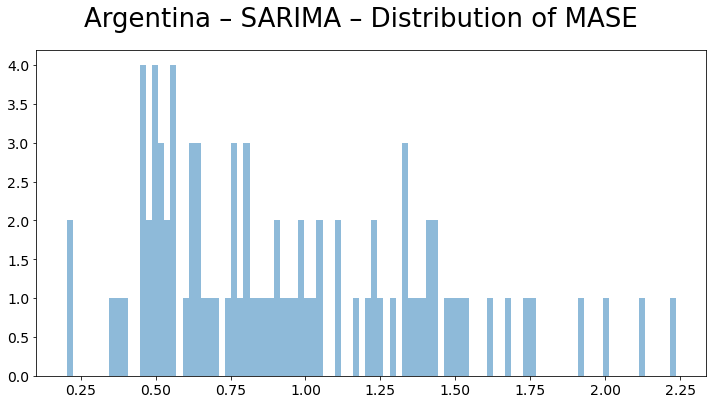

<IPython.core.display.Javascript object>

In [31]:
display(plot_hist_model_scores(data_name, model_name, sarima_test_all_scores, "MASE"))

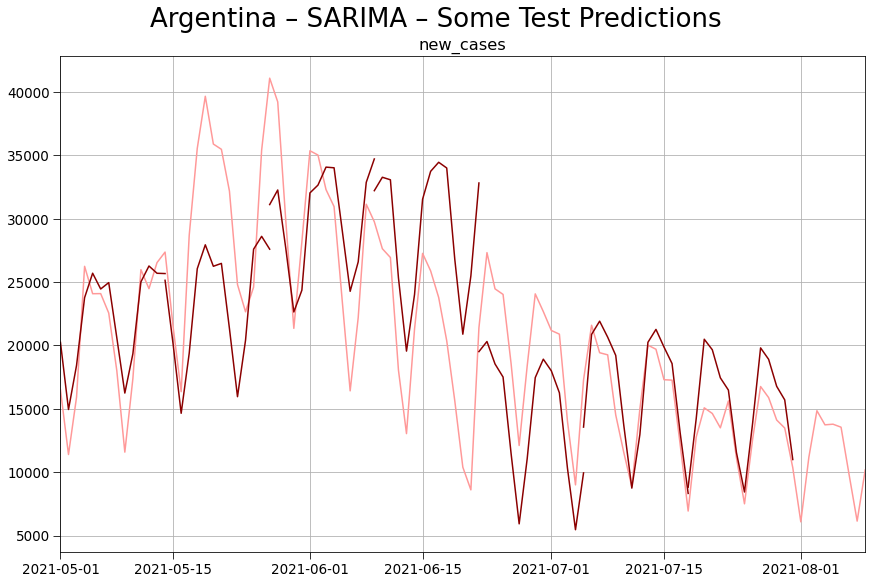

<IPython.core.display.Javascript object>

In [33]:
fig = plot_ground_truth(test_intv, model_name=model_name, data_name=data_name)
display(
    plot_model_test_prediction(test_intv, fig_time_delta, sarima_test_preds, fig=fig)
)

## Forex Currencies Rates: GBP/USD

trans: d=1, lmb=34125.0


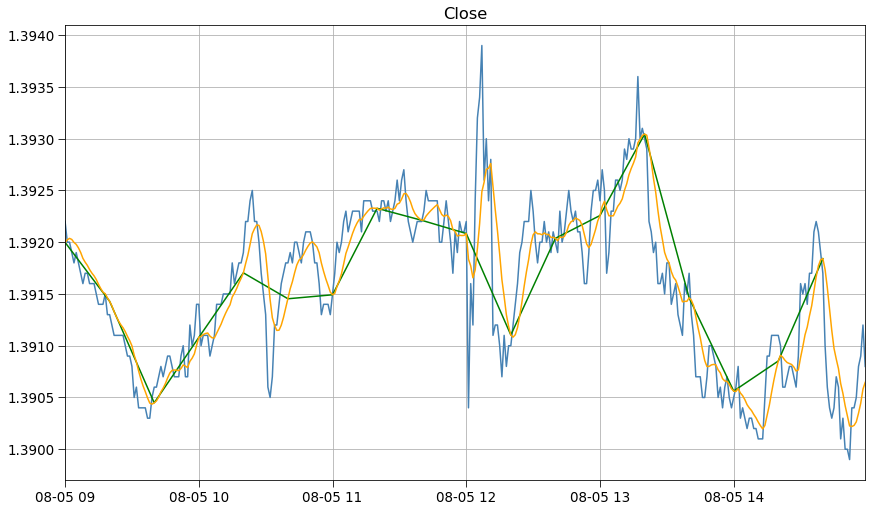

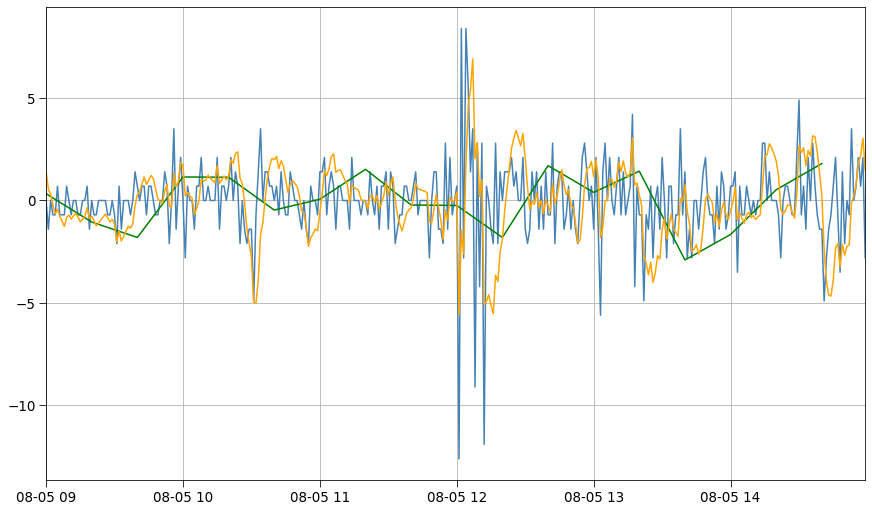

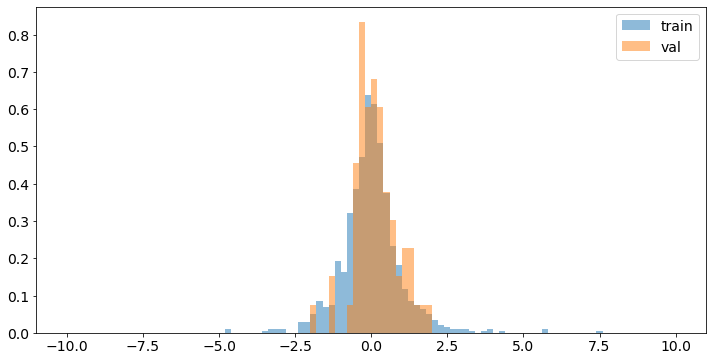

<IPython.core.display.Javascript object>

In [146]:
smoothed_ts = get_smoothed(ts, std=5, only_prevs=True)
smoothed_trans = IHSTransformer(train_intv.view(smoothed_ts))
smoothed_trans_ts = smoothed_trans.transform(smoothed_ts)
print(f"trans: d={smoothed_trans.d}, lmb={smoothed_trans.lmb}")

time_delta = timedelta(minutes=20)
less_granular_ts = get_less_granular_ts(smoothed_ts, time_delta)
less_granular_trans = IHSTransformer(train_intv.view(less_granular_ts))
less_granular_trans_ts = less_granular_trans.transform(less_granular_ts)

fig = plot_ts(intv.view(ts))
plot_ts(intv.view(less_granular_ts), color="green", fig=fig)
display(plot_ts(intv.view(smoothed_ts), color="orange", fig=fig))

fig = plot_ts(intv.view(original_trans_ts))
plot_ts(intv.view(less_granular_trans_ts), color="green", fig=fig)
display(plot_ts(intv.view(smoothed_trans_ts), color="orange", fig=fig))

# fig = plot_ts(trans.detransform(intv.view(original_trans_ts), intv.prev_view(ts)))
# display(
#     plot_ts(
#         smoothed_trans.detransform(
#             intv.view(smoothed_trans_ts), intv.prev_view(smoothed_ts)
#         ),
#         color="orange",
#         fig=fig,
#     )
# )

fig = plot_hist(
    train_intv.view(less_granular_trans_ts),
    bins=100,
    range=(-10, 10),
    density=True,
    name="train",
)
display(
    plot_hist(
        val_intv.view(less_granular_trans_ts),
        bins=100,
        range=(-10, 10),
        density=True,
        name="val",
        fig=fig,
    )
)

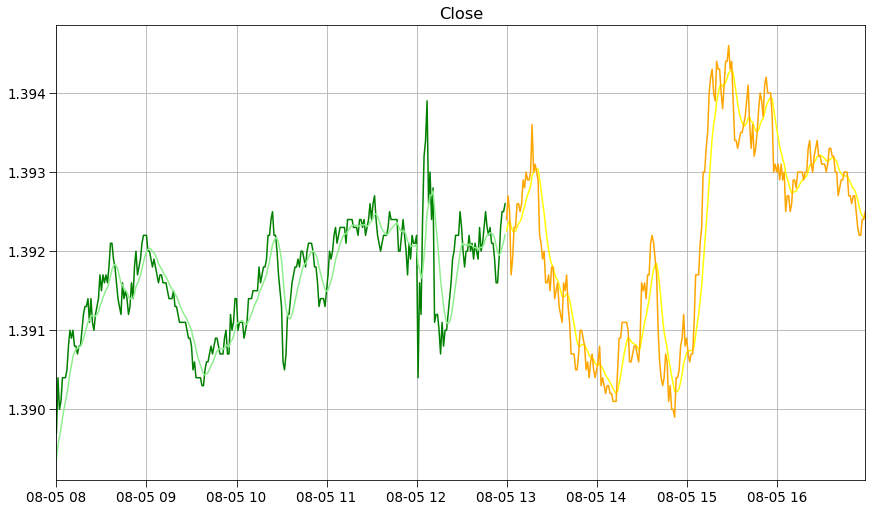

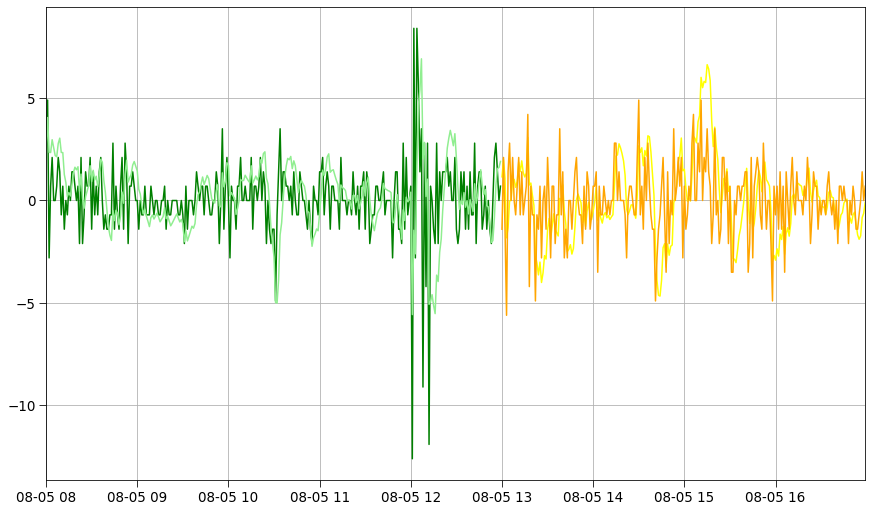

<IPython.core.display.Javascript object>

In [113]:
hyper_search_train_datetime = datetime(2021, 8, 5, 8)
hyper_search_val_datetime = datetime(2021, 8, 5, 13)
hyper_search_end_val_datetime = datetime(2021, 8, 5, 17)
hyper_search_train_intv = tss.Interval(
    ts, hyper_search_train_datetime, hyper_search_val_datetime
)
hyper_search_val_intv = tss.Interval(
    ts, hyper_search_val_datetime, hyper_search_end_val_datetime
)
fig = plot_ts(hyper_search_train_intv.view(), color="green")
plot_ts(hyper_search_train_intv.view(smoothed_ts), color="lightgreen", fig=fig)
plot_ts(hyper_search_val_intv.view(smoothed_ts), color="yellow", fig=fig)
display(plot_ts(hyper_search_val_intv.view(), fig=fig, color="orange"))
fig = plot_ts(hyper_search_train_intv.view(original_trans_ts), color="green")
plot_ts(hyper_search_train_intv.view(smoothed_trans_ts), color="lightgreen", fig=fig)
plot_ts(hyper_search_val_intv.view(smoothed_trans_ts), color="yellow", fig=fig)
display(plot_ts(hyper_search_val_intv.view(original_trans_ts), fig=fig, color="orange"))